In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from helper_functions import *
%load_ext autoreload
%autoreload 2

## Subtask 1
#### Load data, create windows and do PCA om them

Shape of data: (14002, 10)
Maximum number of pedestrians in one cell 200.0
Minimum number of pedestrians in one cell 0.0


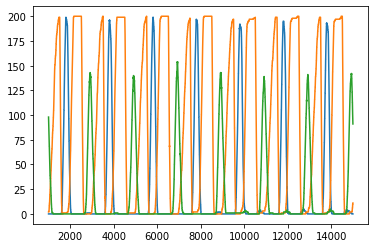

In [2]:
mi = np.genfromtxt('data/MI_timesteps.txt',skip_header=1000)
max_ped = np.max(mi[:, 1:])
min_ped = np.min(mi[:, 1:])
print(f'Shape of data: {mi.shape}')
print(f'Maximum number of pedestrians in one cell {np.max(mi[:, 1:])}')
print(f'Minimum number of pedestrians in one cell {np.min(mi[:, 1:])}')
plt.plot(mi[:,0],mi[:,1])
plt.plot(mi[:,0],mi[:,2])
plt.plot(mi[:,0],mi[:,3])
plt.show()

In [3]:
window_length = 351
delayed_list = []
for i in range(len(mi)-window_length+1):
    delayed_list.append(mi[i:i+window_length, 1:4].flatten())
delayed = np.vstack(delayed_list)
print(f'Shape of generated data: {delayed.shape}')

Shape of generated data: (13652, 1053)


In [4]:
pca = PCA(n_components=3, random_state=42)
pca.fit(delayed)
for i in range(len(pca.explained_variance_ratio_)):
    exp_var = np.sum(pca.explained_variance_ratio_[:i+1])
    print(f'\"Energy\" (explained variance) from including {i+1} components: {round(exp_var, 3)} ')
transformed = pca.transform(delayed)
print(f'Shape of tranformed data: {transformed.shape}')

"Energy" (explained variance) from including 1 components: 0.458 
"Energy" (explained variance) from including 2 components: 0.689 
"Energy" (explained variance) from including 3 components: 0.829 
Shape of tranformed data: (13652, 3)


## Subtask 2
#### Plot embedding space and colour by number of pedestrian

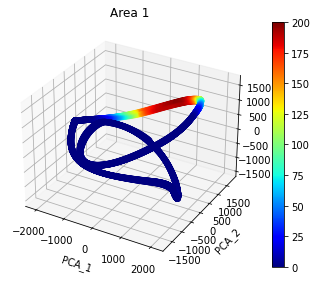

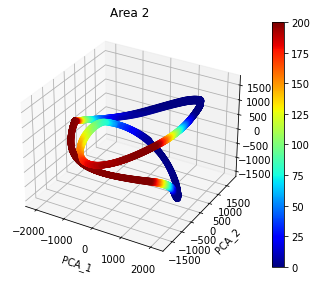

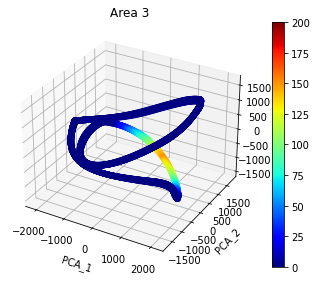

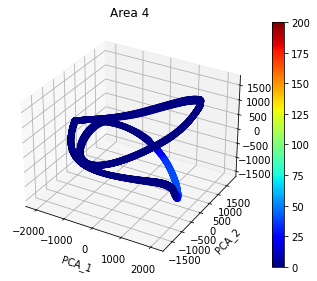

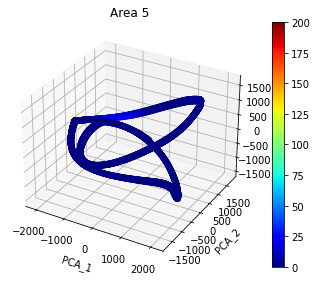

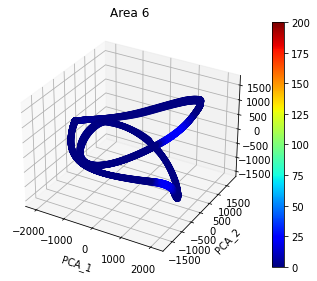

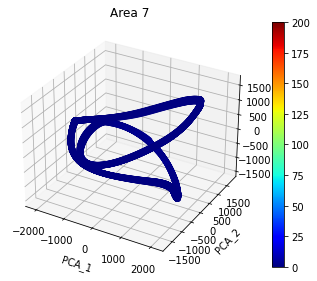

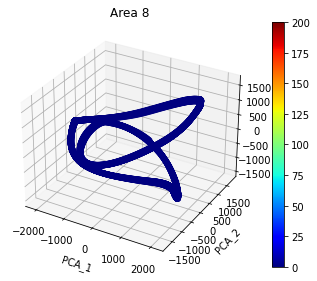

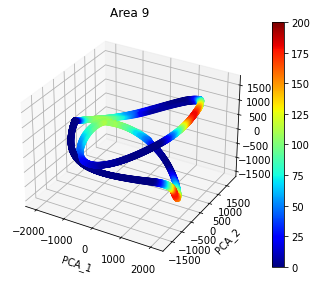

In [5]:
normalize = matplotlib.colors.Normalize(vmin=min_ped, vmax=max_ped)
for i in range(9):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    t = ax.scatter(transformed[:,0], transformed[:,1], transformed[:,2],  c = mi[:len(transformed), i + 1], cmap='jet', norm = normalize)
    ax.set_xlabel("PCA_1")
    ax.set_ylabel("PCA_2")
    ax.set_zlabel("PCA_3")
    ax.set_title(f"Area {i+1}")
    plt.colorbar(t)
    fig.tight_layout()
#plt.show()

## Subtask 3
#### Plot the normalized arclength against the velocity of the arclength

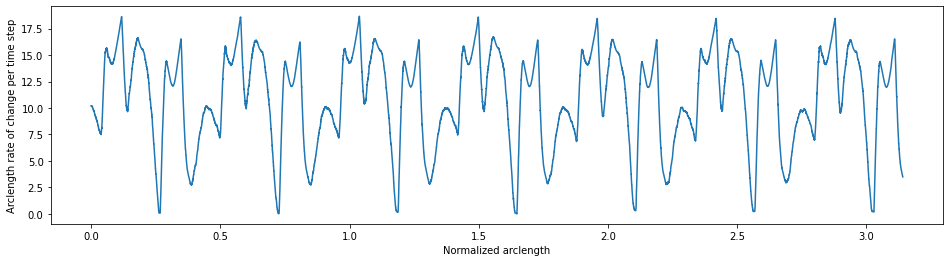

In [6]:
plt.figure(figsize=(16,4))
arclengthdot = np.linalg.norm(np.diff(transformed, axis=0),axis=1)
x = np.linspace(0, np.pi, len(arclengthdot))
plt.plot(x,arclengthdot)
plt.xlabel('Normalized arclength')
plt.ylabel('Arclength rate of change per time step')
plt.show()

#### Learn the arclength

In [7]:
import math
# Set up and train
rbf_periodic = RBF(200, 0.05, periodic=True)
rbf_periodic.fit(x, arclengthdot)

pi = math.pi
# Forecast
next_weeks = np.linspace(pi, 3*pi, 2*len(arclengthdot))

train = rbf_periodic.predict(x)
pred = rbf_periodic.predict(next_weeks)

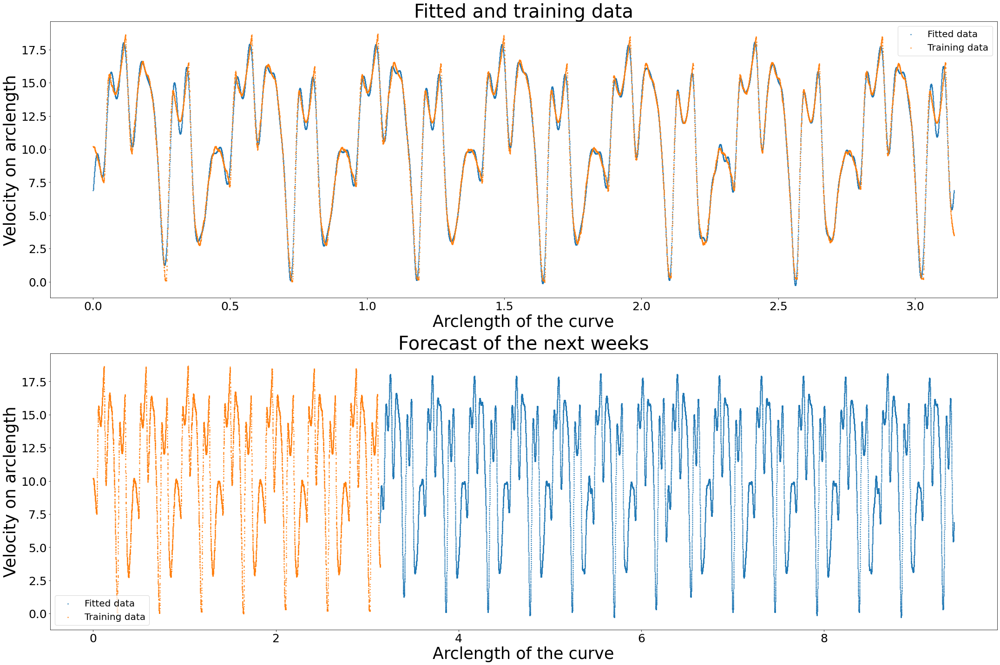

In [8]:
fig, ax = plt.subplots(2,1,figsize=(30,20))

ax[0].scatter(x, train, s=2, label="Fitted data")
ax[0].scatter(x, arclengthdot, s=2, label="Training data")
ax[0].set_title("Fitted and training data", fontsize=40)
ax[0].set_xlabel('Arclength of the curve', fontsize=35)
ax[0].set_ylabel('Velocity on arclength', fontsize=35)
ax[0].tick_params(axis='x', labelsize=25)
ax[0].tick_params(axis='y', labelsize=25)
ax[0].legend(prop={'size': 20})

ax[1].scatter(next_weeks, pred, s=2, label="Fitted data")
ax[1].scatter(x, arclengthdot, s = 2, label="Training data")
ax[1].set_title("Forecast of the next weeks", fontsize=40)
ax[1].set_xlabel('Arclength of the curve', fontsize=35)
ax[1].set_ylabel('Velocity on arclength', fontsize=35)
ax[1].tick_params(axis='x', labelsize=25)
ax[1].tick_params(axis='y', labelsize=25)
ax[1].legend(prop={'size': 20})

fig.tight_layout()

## Subtask 4
#### Predict utilisation of MI building

Using RBF

In [9]:
rbf_MI = RBF(200, 0.05, periodic=True)
first_week_arcspace = np.linspace(0, np.pi, len(mi[:,1]))
first_week_timespace = np.linspace(0, len(mi[:,1]), len(mi[:,1]))

following_weeks_arcspace = np.linspace(np.pi, 3*np.pi, 2*len(mi[:,1]))
following_weeks_timespace = np.linspace(len(mi[:,1]), 3*len(mi[:,1]), 2*len(mi[:,1]))


rbf_MI.fit(first_week_arcspace, mi[:,1])
fitted = rbf_MI.predict(first_week_arcspace)
predicted = rbf_MI.predict(following_weeks_arcspace)

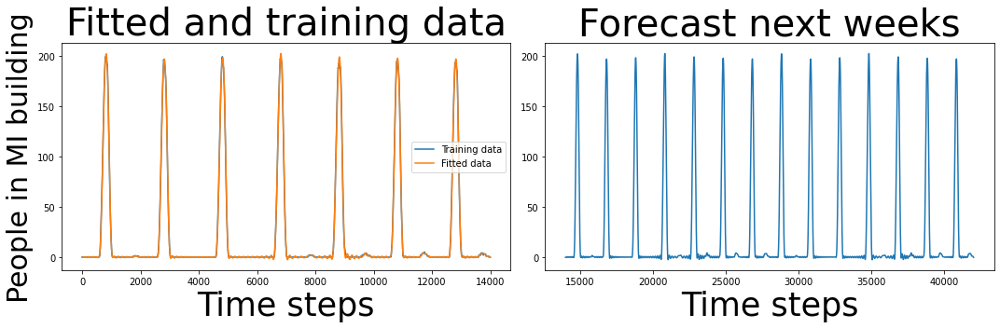

In [10]:
fig, ax = plt.subplots(1,2,figsize=(15,5))

ax[0].plot(mi[:,1], label="Training data")
ax[0].plot(first_week_timespace, fitted, label="Fitted data")
ax[0].set_title('Fitted and training data', fontsize=40)
ax[0].set_xlabel('Time steps', fontsize=35)
ax[0].set_ylabel('People in MI building', fontsize=30)
ax[0].legend(prop={'size': 10})

ax[1].plot(following_weeks_timespace, predicted)
ax[1].set_title("Forecast next weeks", fontsize=40)
ax[1].set_xlabel('Time steps', fontsize=35)

fig.tight_layout()

Using Auto regression (just a "fun" add on)

In [11]:
from statsmodels.tsa.ar_model import AutoReg

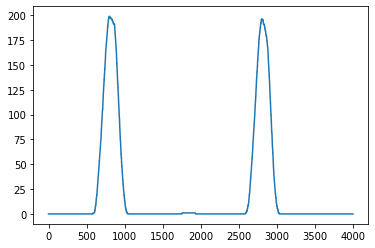

In [12]:
plt.plot(mi[:,1][0:4000])
plt.show()

In [13]:
data = mi[:,1]
last_day = 2000 # The data seems to be periodic by 2000
x_es = [1,2,3,last_day,last_day-2,last_day-1,last_day+2, last_day+1]

model = AutoReg(data.astype(int), lags=x_es, trend='n', old_names=True)
model_fitted = model.fit()

In [14]:
pred = model_fitted.predict(start=0, end=3*len(data))

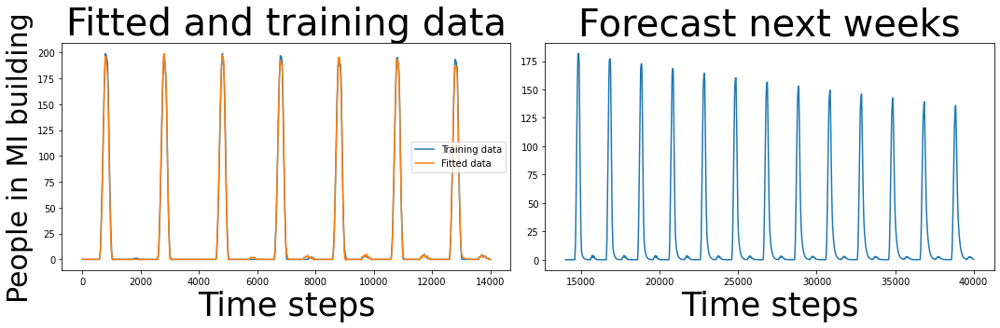

In [15]:
fig, ax = plt.subplots(1,2,figsize=(15,5))

ax[0].plot(data, label="Training data")
ax[0].plot(pred[:len(data)], label="Fitted data")
ax[0].set_title('Fitted and training data', fontsize=40)
ax[0].set_xlabel('Time steps', fontsize=35)
ax[0].set_ylabel('People in MI building', fontsize=30)
ax[0].legend(prop={'size': 10})

next_weeks = np.linspace(len(data), len(pred), len(pred[len(data):]))
ax[1].plot(next_weeks, pred[len(data):])
ax[1].set_title("Forecast next weeks", fontsize=40)
ax[1].set_xlabel('Time steps', fontsize=35)


fig.tight_layout()